# Architecture and Objective Function:
Facenet uses Inception-Resnet_V1 network as the backbone with a siamese network structure. It is trained with triplet loss. Siamese network is dual network with identical weights and architecture that takes an input image of a person and generate the image embedding of it. Then we use the same network without any updates yet and create embedding for another image. Finally a similarity score will be computed using the two embeddings to decide whether two image all same person or not. With a triplet loss function the process is similar. Triplet comes with three images, Anchor, Positive and Negative. Anchor and Positive image will falls into same class (i.e same person) and Anchor and Negative will be different class. The embeddings for these three images will be generated using the same network and a triplet loss function will be used to compute the loss value for this triplet set. The triplet loss function computes the euclidean distance between Anchor and Positive and also between Anchor and Negative. The distance between Anchor and Positive should be smaller than distance between Anchor and Negative. The actual triplet loss is shown below.
$$
L = \max(d(A, P)-d(A,N)+\text {margin}, 0)
$$
As we can see, in order to minimize the triplet loss function the models needs to generate vectors for Anchor and Positive images as close as possible in euclidean space and also generate vectors for Anchor and Negative as far from each other as possible. Margin will be a hyperparameter that controls how far away the dissimilarities for a triplet should be. By using the triplet loss function Facenet will learn to create image embeddings near to each other for images that falls into same class.

# Experiment

## Improve using facenet

The facenet-pytorch packdge provides easy-to-use facenet implementation using Pytorch. We will use its MTCNN and InceptionResnetV1 classes in our experiment. The MTCNN class is a face landmark detector which can cut the original LFW images down to contain only the "face area". The InceptionResnetV1 class with parameter "pretranined" set as "vggface2" loads a pretrained Inception Resnet V1 network, which is the network described in the facenet paper. 



In [1]:
!pip install facenet-pytorch

     |████████████████████████████████| 1.9 MB 28.2 MB/s 


In [2]:
from facenet_pytorch import MTCNN, InceptionResnetV1
from sklearn.neighbors import NearestNeighbors
import numpy as np
import tensorflow_datasets as tfds
import torch

## Get lfw dataset

We will get the LFW dataset using tfds from tensorflow. The parameter "split" is set as "train" just for filling the slot, the whole LFW dataset is contained in the train split. 

In [3]:
ds = tfds.load('lfw', split='train')

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

0 examples [00:00, ? examples/s]

Shuffling and writing examples to /root/tensorflow_datasets/lfw/0.1.0.incompleteNODEDN/lfw-train.tfrecord


  0%|          | 0/13233 [00:00<?, ? examples/s]

Dataset lfw downloaded and prepared to /root/tensorflow_datasets/lfw/0.1.0. Subsequent calls will reuse this data.


## Use facenet to generate vectors

Use GPU to generate vectors. 

In [ ]:
# use GPU if we have one
if torch.cuda.is_available():
  device = 'cuda'
else:
  device = 'cpu'

# mtcnn is required by facenet, it will find and align faces in image
mtcnn = MTCNN(device=device)

# pretrained facenet
model = InceptionResnetV1(pretrained='vggface2', device=device).eval()

# use mtcnn and facenet to generate vectors for the lfw dataset
# save the vectors to disk for later use
with open('vectors.csv', 'ab') as f:
  for example in ds:
    aligned = mtcnn(example['image'].numpy()).to(device)
    vectors = model(aligned[None, :]).detach().cpu()
    np.savetxt(f, vectors, delimiter=',')

    torch.cuda.empty_cache()

  0%|          | 0.00/107M [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:780: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


## KNN search

We are using the NearestNeighbors class from sklearn to generate neighbours for given image queries. 

In [12]:
# get vectors from disk
vectors = np.loadtxt('vectors.csv', float, delimiter=',')

In [13]:
# KNN search for 20 nearest images
knn = NearestNeighbors(n_jobs=-1)
knn.fit(vectors)
neigh = knn.kneighbors(vectors, 20, return_distance=False)

## Evaluate

This part of evaluation is not required by the project, however, we come up with a simple evaluation algorithm since we want to compare the performance of our improved model to our baseline model. The algorithm used will be introduced here as well as the same part in the notebook of our baseline model. 

The idea behind our evaluation algorithm is to find the images of same persons in the dataset. If there are three images of Elon Musk in our dataset, we set one of his image as the input query image, and we can find both other two images of him in the neighbours generated by our model, then we will say our model achieves 100% accuracy. Same process as above, if we only get one of the other two images of Elon Musk, we will say out model achieves 50% of accuracy. For those people with only one image in the dataset, we ignore them when computing accuracy but we do not ignore their images during computing accuracy for other people. 

We can find the accuracy of the facenet model is pretty good, we can nearly find all same person iamges. 

In [4]:
# get labels from lfw dataset
labels = []
for example in ds:
  labels.append(example['label'].numpy().decode("ascii"))

In [ ]:
# 5749 people in total
faces_per_person = {}

for label in labels:
  if label not in faces_per_person:
    faces_per_person[label] = 1
  else:
    faces_per_person[label] += 1

acc = 0
for n in neigh:
  faces_cur_person = faces_per_person[labels[n[0]]]

  # we don't want person with only 1 image during evaluation
  # but we can use them as noise so skip them
  if faces_cur_person == 1:
    continue

  # we calculate 20 nearest neighbours, so 20 as maximum
  if faces_cur_person > 20:
    faces_cur_person = 20
  
  cnt = 0
  for i in range(20):
    if labels[n[i]] == labels[n[0]]:
      cnt += 1

  acc += (cnt-1)/(faces_cur_person-1)

# 9164 images of 1680 people with 2 or more images
print(acc/9164)

0.9255254728450611


## Show faces

We will show the image query results in this section. The 10 query faces are given in slack. 

We can find out that the query results are pretty good except for the 8th query. For this query, we can conclude that the MTCNN model is not generating the correct person of interest because we can find all result images look a lot like the men on the left. 

In [14]:
from google.colab.patches import cv2_imshow

# function to print searching and result images
def generate_knn_images(neighbours, ds, labels):
  images = {}

  cnt = 0
  for example in ds:
    if cnt in neighbours:
      images[np.where(neighbours == cnt)[0][0]] = example['image'].numpy()[...,::-1]
    cnt += 1

  for i in range(len(neighbours)):
    if i == 0:
      print("Searching: ")
    else:
      print("Result at index {} : ".format(i))
    
    cv2_imshow(images[i])

    print("Name of above image: {}".format(labels[neighbours[i]]))

  print("\n---------\n")

In [ ]:
# names of the person in the query images
# we only use this part to figure out the target images
names = ["Albert_Costa", "Angela_Bassett", "Arminio_Fraga", "Billy_Crystal", "Bob_Graham", 
         "Boris_Becker", "Bulent_Ecevit", "Calista_Flockhart", "Cameron_Diaz", "Carmen_Electra"]

In [64]:
# query images
# we hard-code these numbers for convenience
targets = [1672, 6139, 5374, 4900, 7186, 11623, 9447, 8958, 3473, 12839]

Searching: 


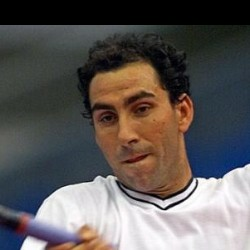

Name of above image: Albert_Costa
Result at index 1 : 


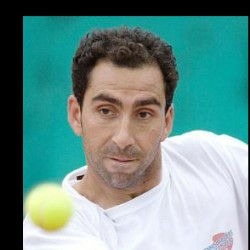

Name of above image: Albert_Costa
Result at index 2 : 


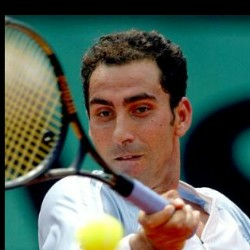

Name of above image: Albert_Costa
Result at index 3 : 


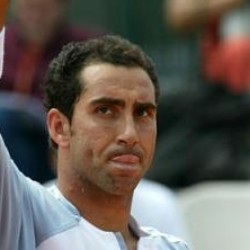

Name of above image: Albert_Costa
Result at index 4 : 


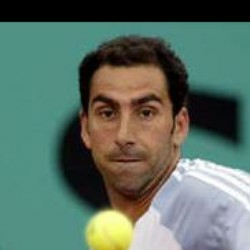

Name of above image: Albert_Costa
Result at index 5 : 


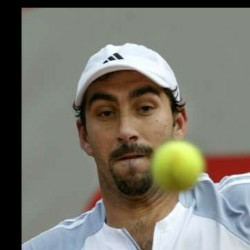

Name of above image: Albert_Costa
Result at index 6 : 


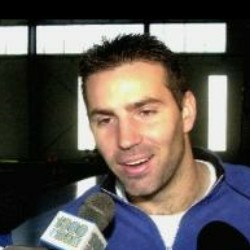

Name of above image: Kurt_Warner
Result at index 7 : 


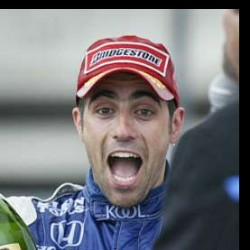

Name of above image: Dario_Franchitti
Result at index 8 : 


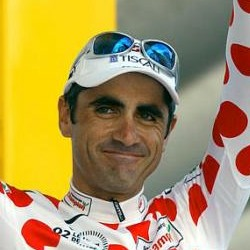

Name of above image: Laurent_Jalabert
Result at index 9 : 


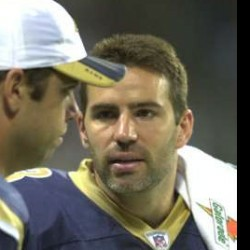

Name of above image: Kurt_Warner
Result at index 10 : 


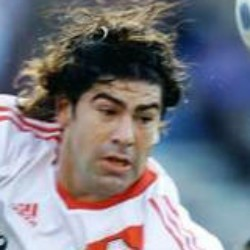

Name of above image: Marcelo_Salas
Result at index 11 : 


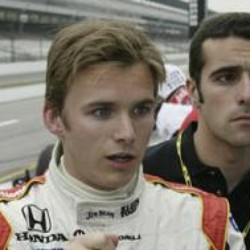

Name of above image: Dan_Wheldon
Result at index 12 : 


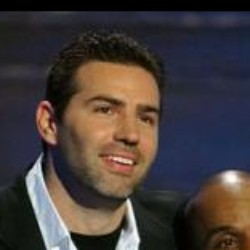

Name of above image: Kurt_Warner
Result at index 13 : 


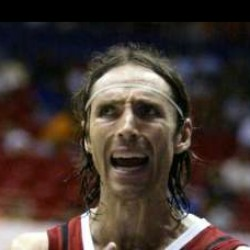

Name of above image: Steve_Nash
Result at index 14 : 


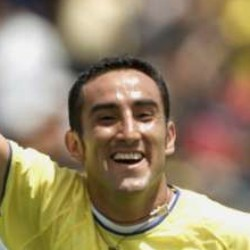

Name of above image: Christian_Patino
Result at index 15 : 


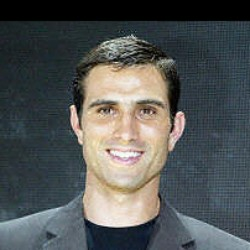

Name of above image: Pedro_Pauleta
Result at index 16 : 


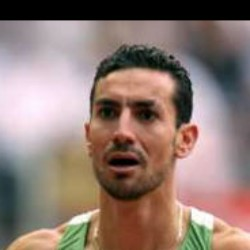

Name of above image: Djabir_Said-Guerni
Result at index 17 : 


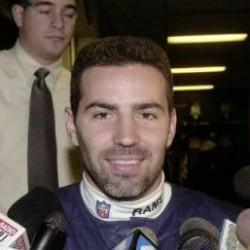

Name of above image: Kurt_Warner
Result at index 18 : 


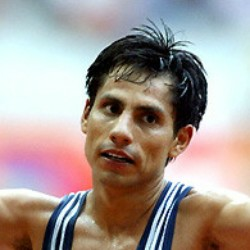

Name of above image: Jefferson_Perez
Result at index 19 : 


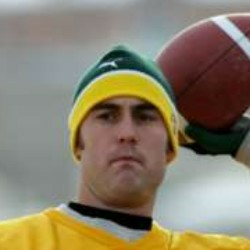

Name of above image: Bart_Hendricks

---------



In [65]:
# show search results
generate_knn_images(neigh[targets[0]], ds, labels)

Searching: 


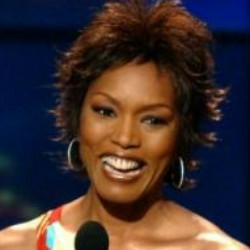

Name of above image: Angela_Bassett
Result at index 1 : 


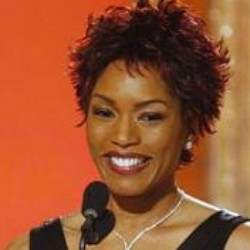

Name of above image: Angela_Bassett
Result at index 2 : 


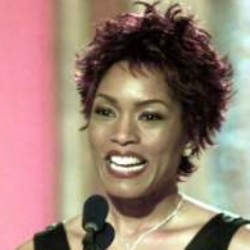

Name of above image: Angela_Bassett
Result at index 3 : 


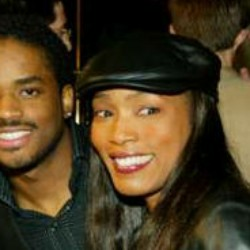

Name of above image: Angela_Bassett
Result at index 4 : 


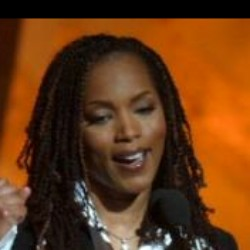

Name of above image: Angela_Bassett
Result at index 5 : 


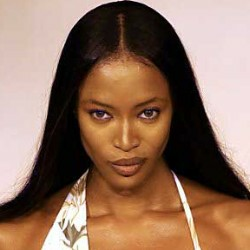

Name of above image: Naomi_Campbell
Result at index 6 : 


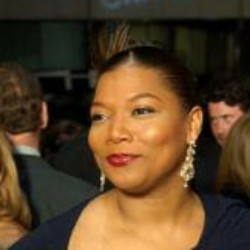

Name of above image: Queen_Latifah
Result at index 7 : 


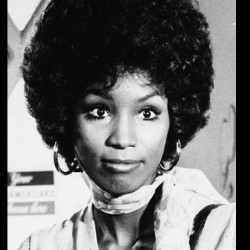

Name of above image: Teresa_Graves
Result at index 8 : 


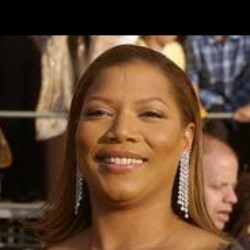

Name of above image: Queen_Latifah
Result at index 9 : 


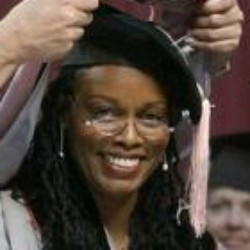

Name of above image: Dianne_Reeves
Result at index 10 : 


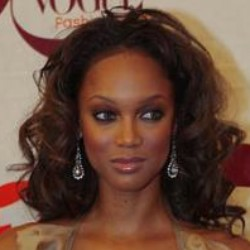

Name of above image: Tyra_Banks
Result at index 11 : 


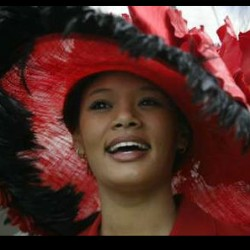

Name of above image: Desiree_McKenzie
Result at index 12 : 


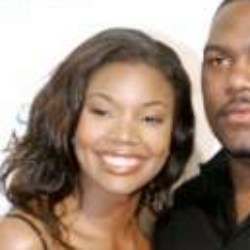

Name of above image: Gabrielle_Union
Result at index 13 : 


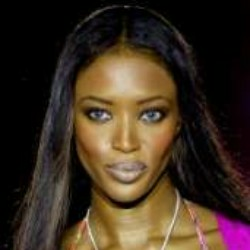

Name of above image: Naomi_Campbell
Result at index 14 : 


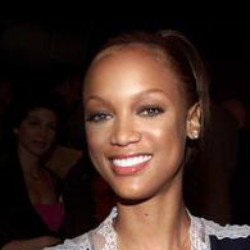

Name of above image: Tyra_Banks
Result at index 15 : 


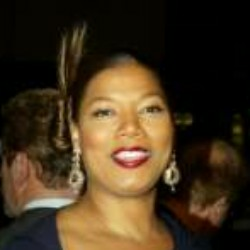

Name of above image: Queen_Latifah
Result at index 16 : 


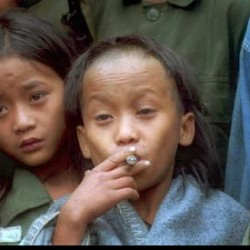

Name of above image: Luther_Htu
Result at index 17 : 


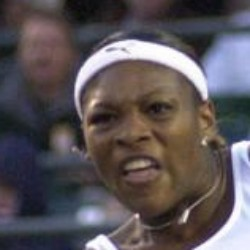

Name of above image: Serena_Williams
Result at index 18 : 


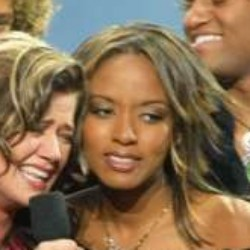

Name of above image: Nikki_McKibbin
Result at index 19 : 


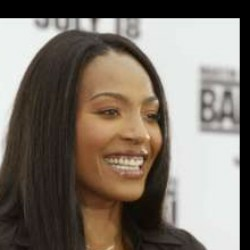

Name of above image: Nona_Gaye

---------



In [66]:
# show search results
generate_knn_images(neigh[targets[1]], ds, labels)

Searching: 


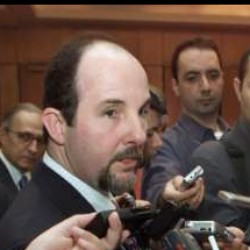

Name of above image: Arminio_Fraga
Result at index 1 : 


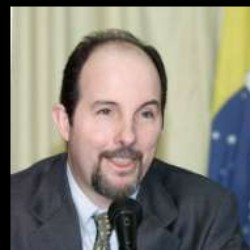

Name of above image: Arminio_Fraga
Result at index 2 : 


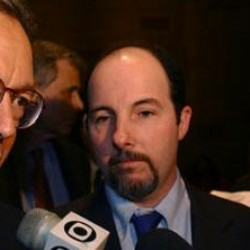

Name of above image: Arminio_Fraga
Result at index 3 : 


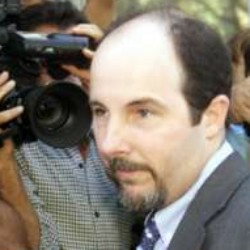

Name of above image: Arminio_Fraga
Result at index 4 : 


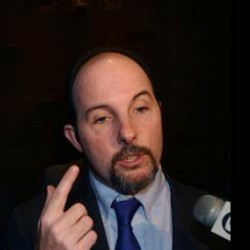

Name of above image: Arminio_Fraga
Result at index 5 : 


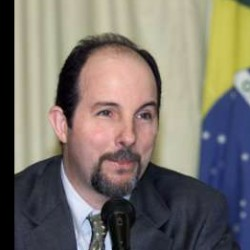

Name of above image: Arminio_Fraga
Result at index 6 : 


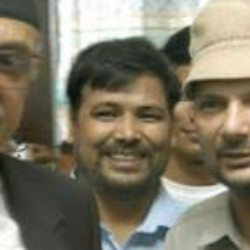

Name of above image: Krishna_Bhadur_Mahara
Result at index 7 : 


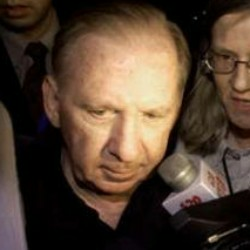

Name of above image: Thomas_OBrien
Result at index 8 : 


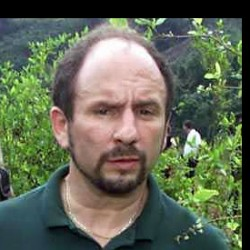

Name of above image: Paul_Wellstone
Result at index 9 : 


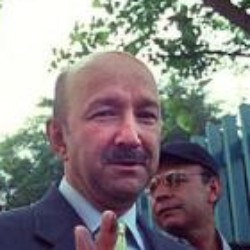

Name of above image: Carlos_Salinas
Result at index 10 : 


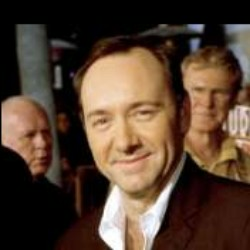

Name of above image: Kevin_Spacey
Result at index 11 : 


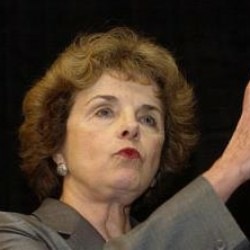

Name of above image: Dianne_Feinstein
Result at index 12 : 


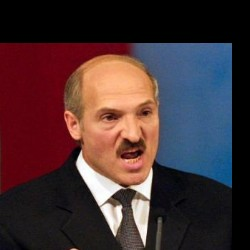

Name of above image: Alexander_Lukashenko
Result at index 13 : 


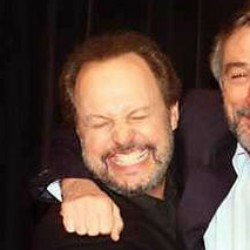

Name of above image: Billy_Crystal
Result at index 14 : 


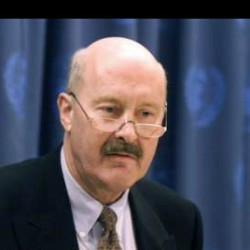

Name of above image: Gunter_Pleuger
Result at index 15 : 


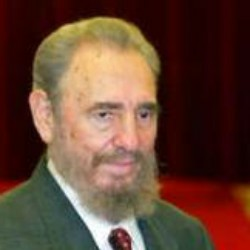

Name of above image: Fidel_Castro
Result at index 16 : 


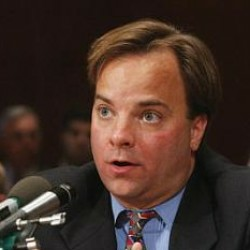

Name of above image: Mark_McClellan
Result at index 17 : 


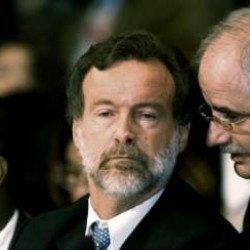

Name of above image: Rafael_Bielsa
Result at index 18 : 


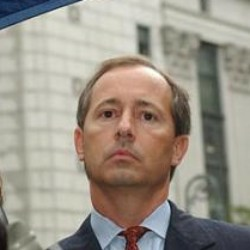

Name of above image: David_Myers
Result at index 19 : 


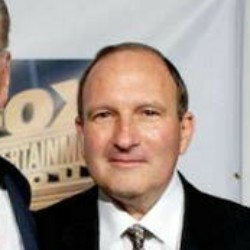

Name of above image: Gary_Gitnick

---------



In [67]:
# show search results
generate_knn_images(neigh[targets[2]], ds, labels)

Searching: 


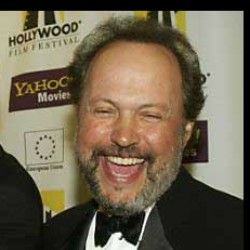

Name of above image: Billy_Crystal
Result at index 1 : 


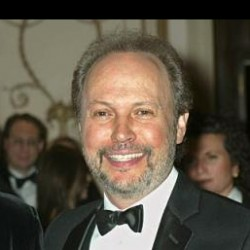

Name of above image: Billy_Crystal
Result at index 2 : 


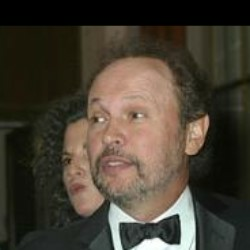

Name of above image: Billy_Crystal
Result at index 3 : 


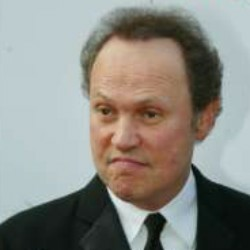

Name of above image: Billy_Crystal
Result at index 4 : 


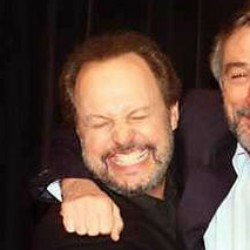

Name of above image: Billy_Crystal
Result at index 5 : 


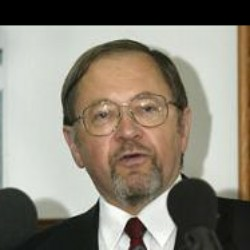

Name of above image: John_Blaney
Result at index 6 : 


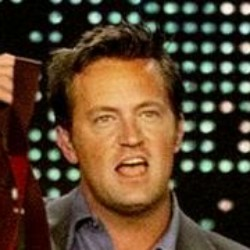

Name of above image: Matthew_Perry
Result at index 7 : 


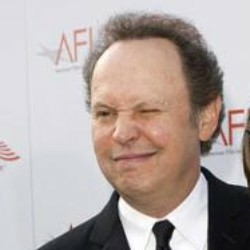

Name of above image: Billy_Crystal
Result at index 8 : 


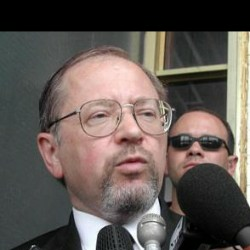

Name of above image: John_Blaney
Result at index 9 : 


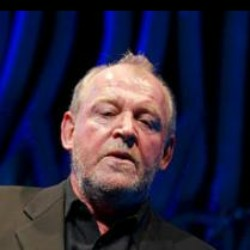

Name of above image: Joe_Cocker
Result at index 10 : 


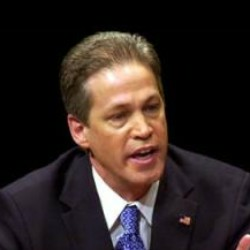

Name of above image: Norm_Coleman
Result at index 11 : 


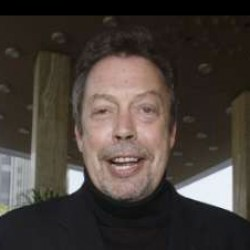

Name of above image: Tim_Curry
Result at index 12 : 


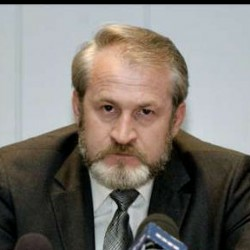

Name of above image: Akhmed_Zakayev
Result at index 13 : 


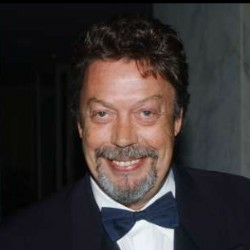

Name of above image: Tim_Curry
Result at index 14 : 


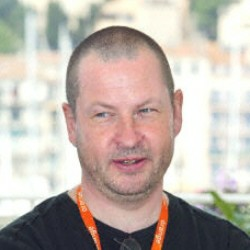

Name of above image: Lars_Von_Trier
Result at index 15 : 


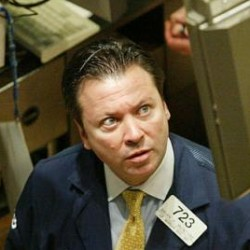

Name of above image: Brian_McIntyre
Result at index 16 : 


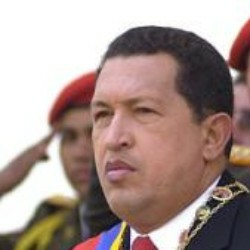

Name of above image: Hugo_Chavez
Result at index 17 : 


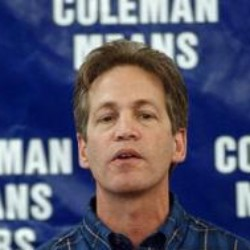

Name of above image: Norm_Coleman
Result at index 18 : 


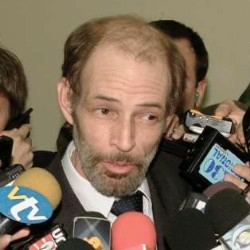

Name of above image: Alejandro_Atchugarry
Result at index 19 : 


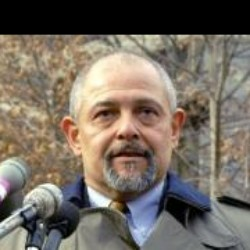

Name of above image: Michael_Arif

---------



In [68]:
# show search results
generate_knn_images(neigh[targets[3]], ds, labels)

Searching: 


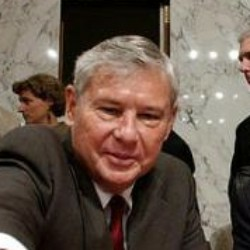

Name of above image: Bob_Graham
Result at index 1 : 


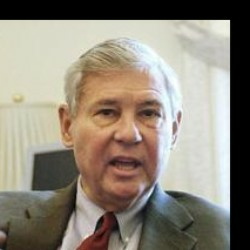

Name of above image: Bob_Graham
Result at index 2 : 


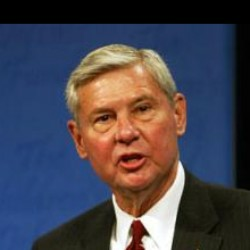

Name of above image: Bob_Graham
Result at index 3 : 


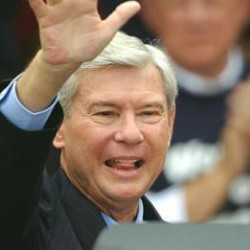

Name of above image: Bob_Graham
Result at index 4 : 


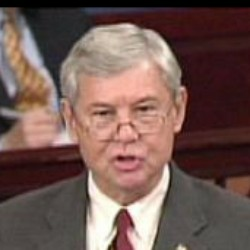

Name of above image: Bob_Graham
Result at index 5 : 


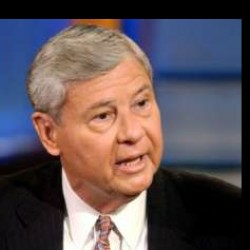

Name of above image: Bob_Graham
Result at index 6 : 


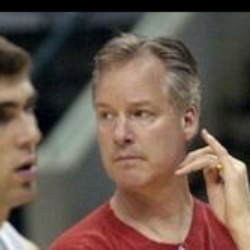

Name of above image: Barry_Collier
Result at index 7 : 


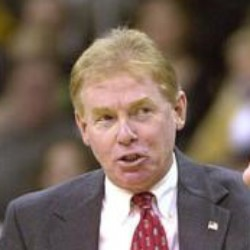

Name of above image: Skip_Prosser
Result at index 8 : 


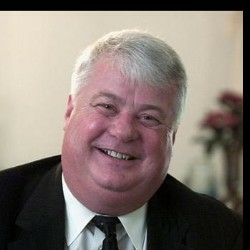

Name of above image: Fred_Huff
Result at index 9 : 


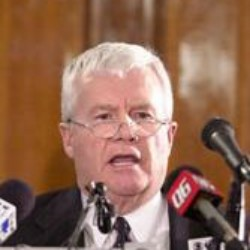

Name of above image: Tom_Moss
Result at index 10 : 


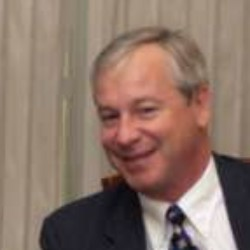

Name of above image: Philip_Murtaugh
Result at index 11 : 


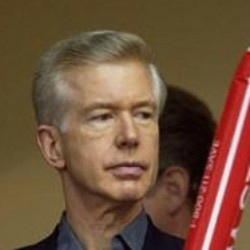

Name of above image: Gray_Davis
Result at index 12 : 


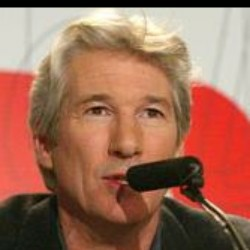

Name of above image: Richard_Gere
Result at index 13 : 


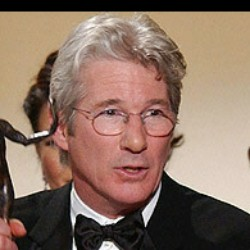

Name of above image: Richard_Gere
Result at index 14 : 


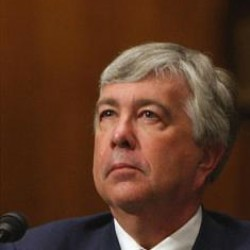

Name of above image: James_Young
Result at index 15 : 


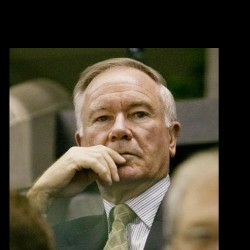

Name of above image: Rod_Bryden
Result at index 16 : 


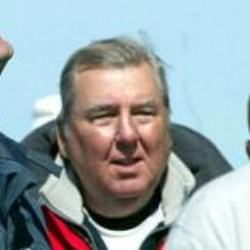

Name of above image: Peter_Harrison
Result at index 17 : 


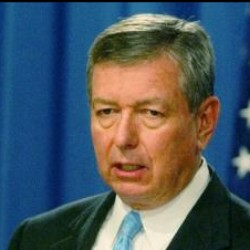

Name of above image: John_Ashcroft
Result at index 18 : 


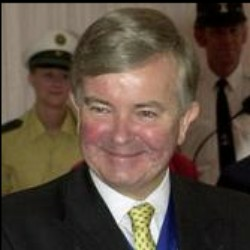

Name of above image: Gavyn_Arthur
Result at index 19 : 


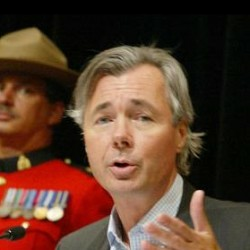

Name of above image: Pierre_Pettigrew

---------



In [69]:
# show search results
generate_knn_images(neigh[targets[4]], ds, labels)

Searching: 


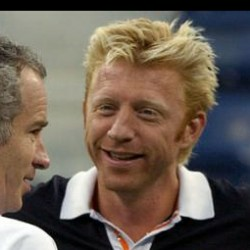

Name of above image: Boris_Becker
Result at index 1 : 


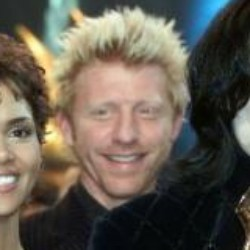

Name of above image: Boris_Becker
Result at index 2 : 


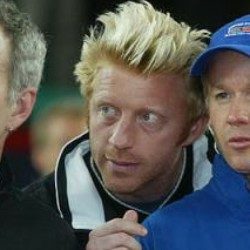

Name of above image: Boris_Becker
Result at index 3 : 


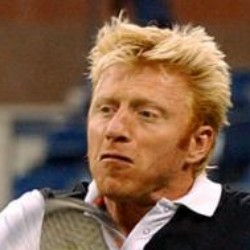

Name of above image: Boris_Becker
Result at index 4 : 


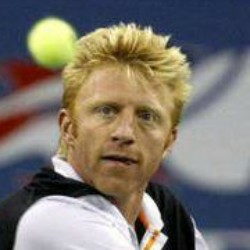

Name of above image: Boris_Becker
Result at index 5 : 


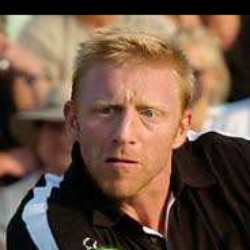

Name of above image: Boris_Becker
Result at index 6 : 


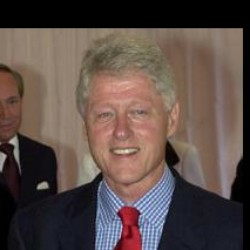

Name of above image: Bill_Clinton
Result at index 7 : 


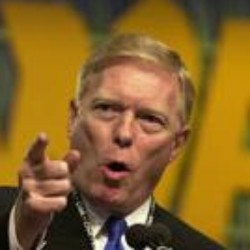

Name of above image: Richard_Gephardt
Result at index 8 : 


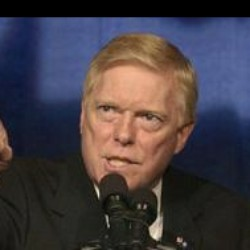

Name of above image: Richard_Gephardt
Result at index 9 : 


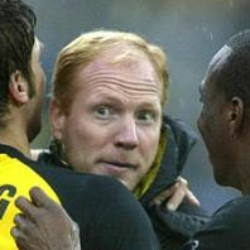

Name of above image: Matthias_Sammer
Result at index 10 : 


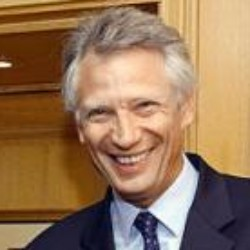

Name of above image: Dominique_de_Villepin
Result at index 11 : 


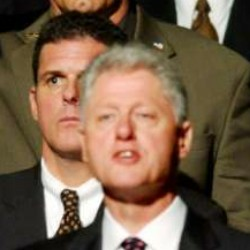

Name of above image: Bill_Clinton
Result at index 12 : 


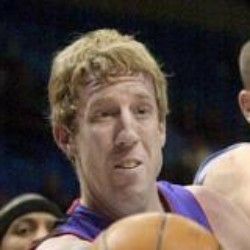

Name of above image: Nate_Huffman
Result at index 13 : 


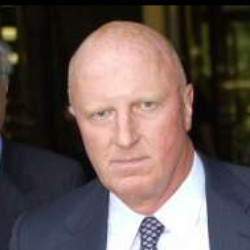

Name of above image: Dennis_Kozlowski
Result at index 14 : 


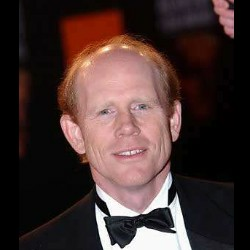

Name of above image: Ron_Howard
Result at index 15 : 


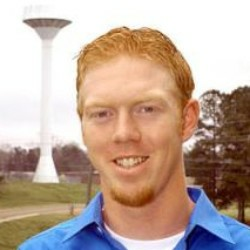

Name of above image: Shane_Phillips
Result at index 16 : 


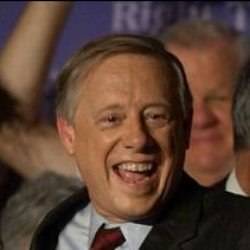

Name of above image: Phil_Bredesen
Result at index 17 : 


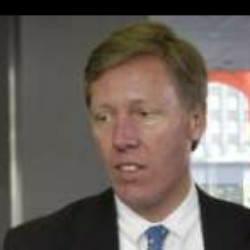

Name of above image: Jake_Brace
Result at index 18 : 


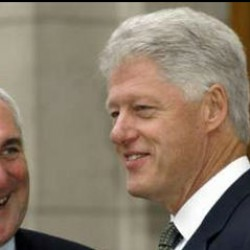

Name of above image: Bill_Clinton
Result at index 19 : 


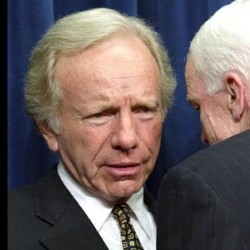

Name of above image: Joe_Lieberman

---------



In [70]:
# show search results
generate_knn_images(neigh[targets[5]], ds, labels)

Searching: 


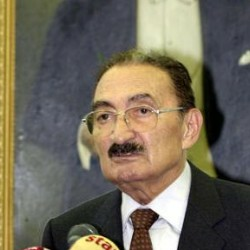

Name of above image: Bulent_Ecevit
Result at index 1 : 


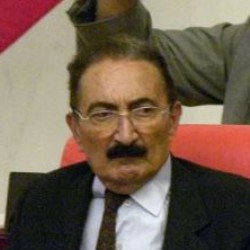

Name of above image: Bulent_Ecevit
Result at index 2 : 


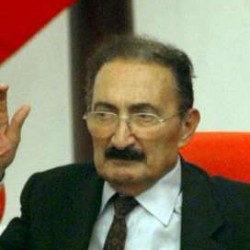

Name of above image: Bulent_Ecevit
Result at index 3 : 


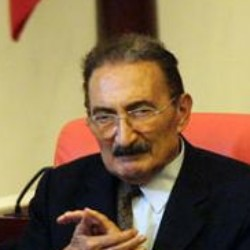

Name of above image: Bulent_Ecevit
Result at index 4 : 


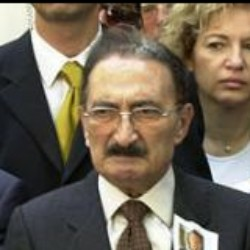

Name of above image: Bulent_Ecevit
Result at index 5 : 


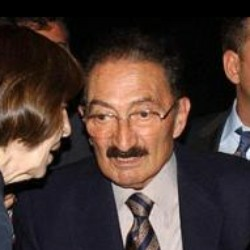

Name of above image: Bulent_Ecevit
Result at index 6 : 


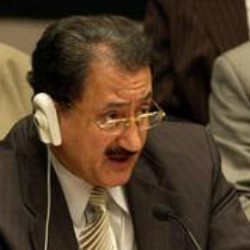

Name of above image: Abdul_Majeed_Shobokshi
Result at index 7 : 


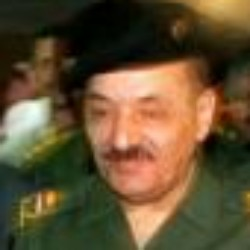

Name of above image: Taha_Yassin_Ramadan
Result at index 8 : 


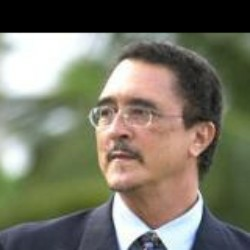

Name of above image: Lucia_Kenny_Anthony
Result at index 9 : 


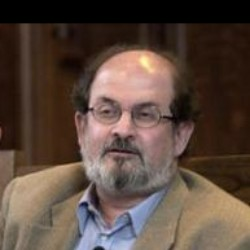

Name of above image: Salman_Rushdie
Result at index 10 : 


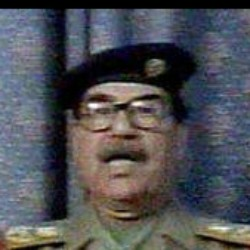

Name of above image: Saddam_Hussein
Result at index 11 : 


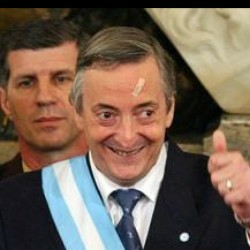

Name of above image: Nestor_Kirchner
Result at index 12 : 


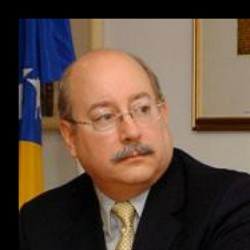

Name of above image: Donald_Hays
Result at index 13 : 


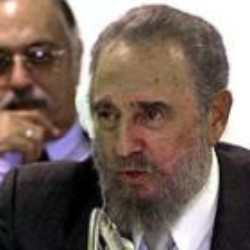

Name of above image: Fidel_Castro
Result at index 14 : 


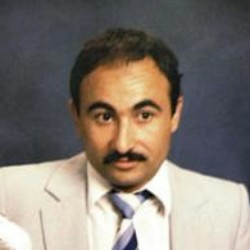

Name of above image: Mamdouh_Habib
Result at index 15 : 


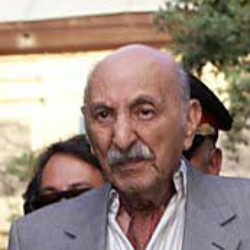

Name of above image: Zahir_Shah
Result at index 16 : 


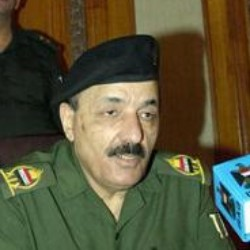

Name of above image: Taha_Yassin_Ramadan
Result at index 17 : 


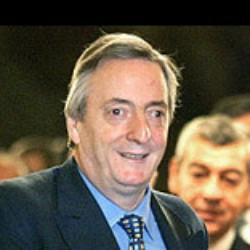

Name of above image: Nestor_Kirchner
Result at index 18 : 


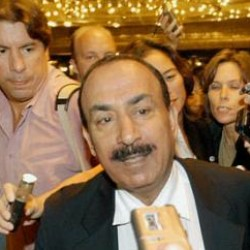

Name of above image: Sadam_Hassan
Result at index 19 : 


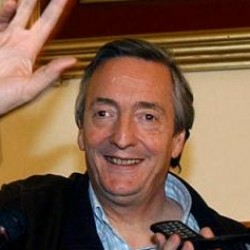

Name of above image: Nestor_Kirchner

---------



In [71]:
# show search results
generate_knn_images(neigh[targets[6]], ds, labels)

Searching: 


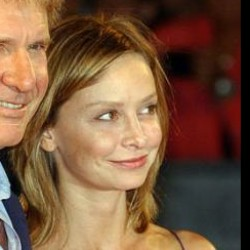

Name of above image: Calista_Flockhart
Result at index 1 : 


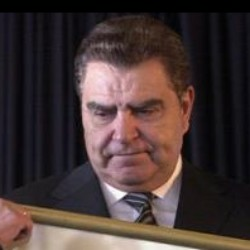

Name of above image: Mario_Kreutzberger
Result at index 2 : 


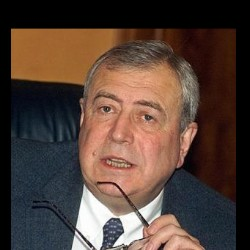

Name of above image: Alexander_Rumyantsev
Result at index 3 : 


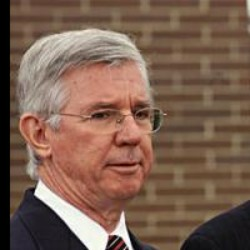

Name of above image: Parris_Glendening
Result at index 4 : 


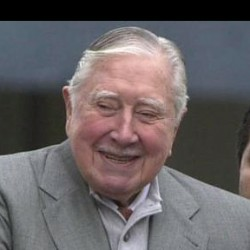

Name of above image: Augusto_Pinochet
Result at index 5 : 


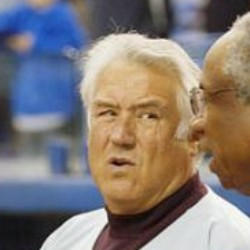

Name of above image: Buck_Rodgers
Result at index 6 : 


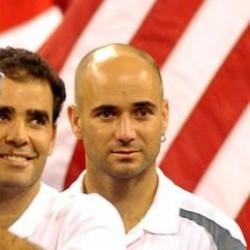

Name of above image: Andre_Agassi
Result at index 7 : 


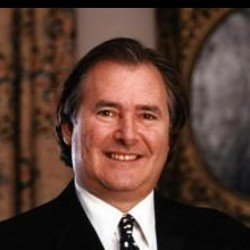

Name of above image: Gary_Winnick
Result at index 8 : 


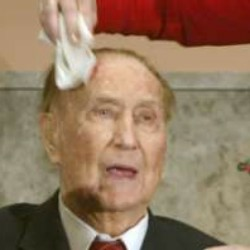

Name of above image: Strom_Thurmond
Result at index 9 : 


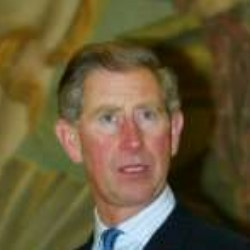

Name of above image: Prince_Charles
Result at index 10 : 


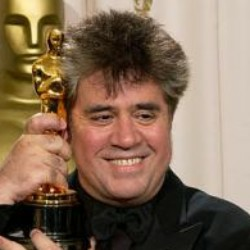

Name of above image: Pedro_Almodovar
Result at index 11 : 


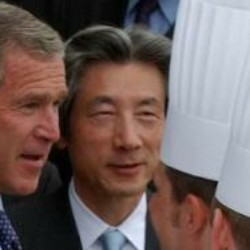

Name of above image: Junichiro_Koizumi
Result at index 12 : 


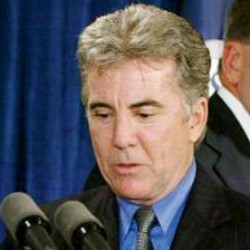

Name of above image: John_Walsh
Result at index 13 : 


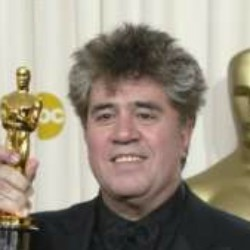

Name of above image: Pedro_Almodovar
Result at index 14 : 


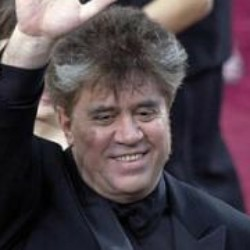

Name of above image: Pedro_Almodovar
Result at index 15 : 


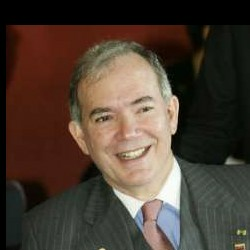

Name of above image: Roy_Chaderton
Result at index 16 : 


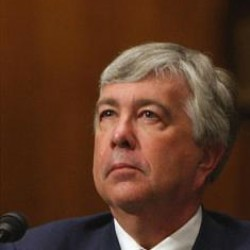

Name of above image: James_Young
Result at index 17 : 


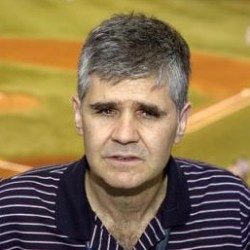

Name of above image: Enrique_Oliu
Result at index 18 : 


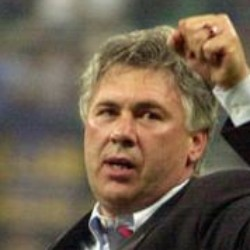

Name of above image: Carlo_Ancelotti
Result at index 19 : 


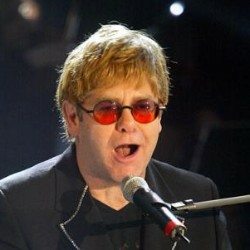

Name of above image: Elton_John

---------



In [72]:
# show search results
generate_knn_images(neigh[targets[7]], ds, labels)

Searching: 


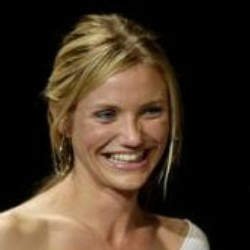

Name of above image: Cameron_Diaz
Result at index 1 : 


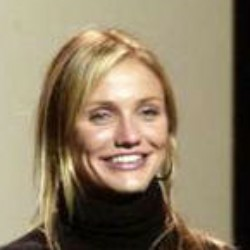

Name of above image: Cameron_Diaz
Result at index 2 : 


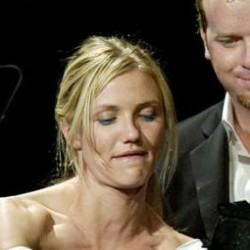

Name of above image: Cameron_Diaz
Result at index 3 : 


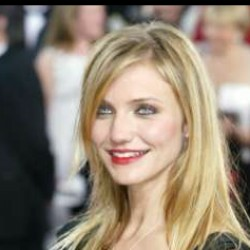

Name of above image: Cameron_Diaz
Result at index 4 : 


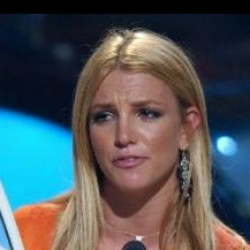

Name of above image: Britney_Spears
Result at index 5 : 


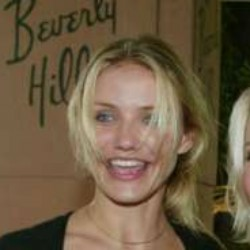

Name of above image: Cameron_Diaz
Result at index 6 : 


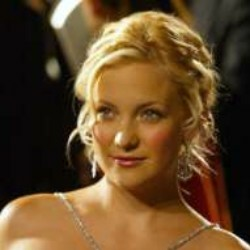

Name of above image: Kate_Hudson
Result at index 7 : 


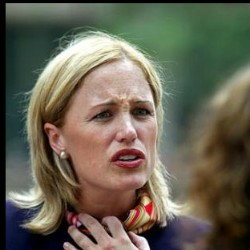

Name of above image: Donna_Morrissey
Result at index 8 : 


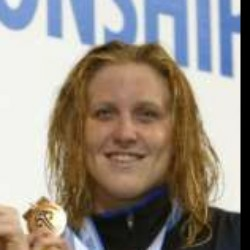

Name of above image: Emily_Mason
Result at index 9 : 


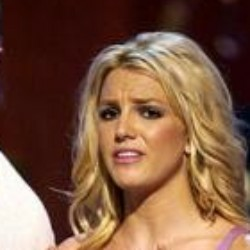

Name of above image: Britney_Spears
Result at index 10 : 


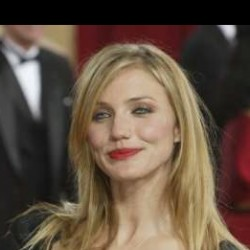

Name of above image: Cameron_Diaz
Result at index 11 : 


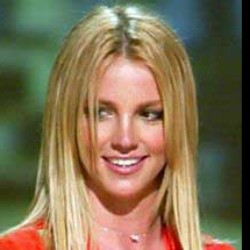

Name of above image: Britney_Spears
Result at index 12 : 


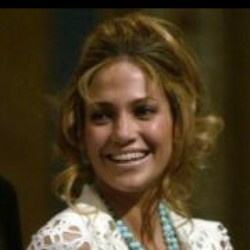

Name of above image: Jennifer_Lopez
Result at index 13 : 


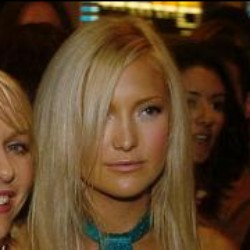

Name of above image: Kate_Hudson
Result at index 14 : 


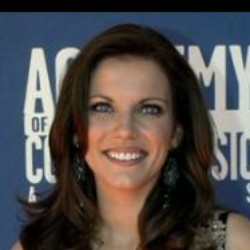

Name of above image: Martina_McBride
Result at index 15 : 


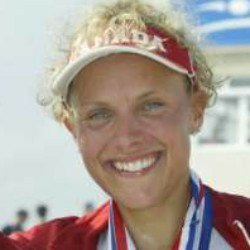

Name of above image: Gen_Meredith
Result at index 16 : 


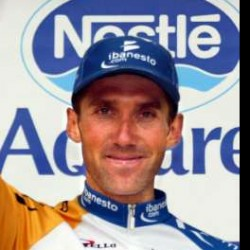

Name of above image: Pablo_Latras
Result at index 17 : 


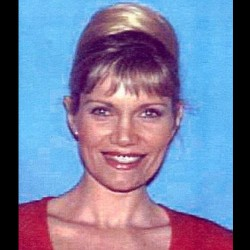

Name of above image: Lana_Clarkson
Result at index 18 : 


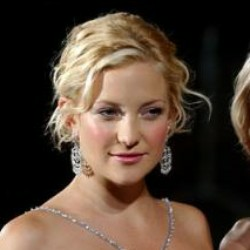

Name of above image: Kate_Hudson
Result at index 19 : 


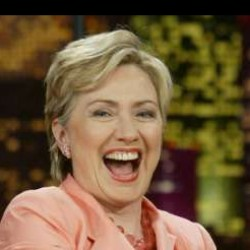

Name of above image: Hillary_Clinton

---------



In [73]:
# show search results
generate_knn_images(neigh[targets[8]], ds, labels)

Searching: 


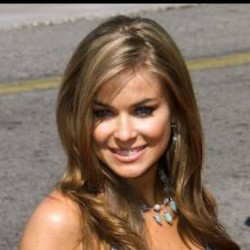

Name of above image: Carmen_Electra
Result at index 1 : 


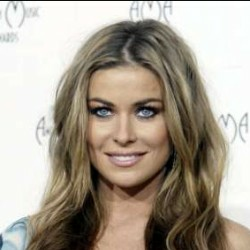

Name of above image: Carmen_Electra
Result at index 2 : 


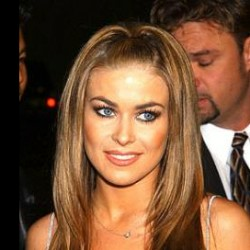

Name of above image: Carmen_Electra
Result at index 3 : 


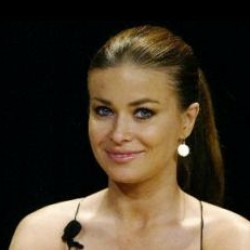

Name of above image: Carmen_Electra
Result at index 4 : 


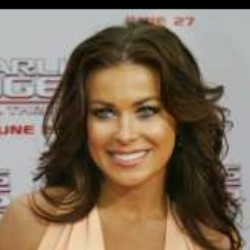

Name of above image: Carmen_Electra
Result at index 5 : 


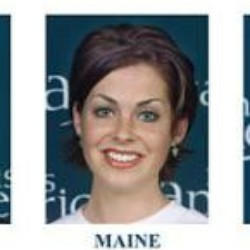

Name of above image: Rachel_Wadsworth
Result at index 6 : 


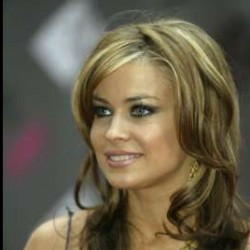

Name of above image: Carmen_Electra
Result at index 7 : 


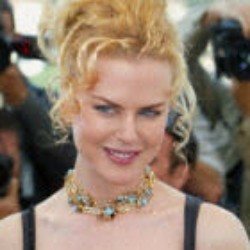

Name of above image: Nicole_Kidman
Result at index 8 : 


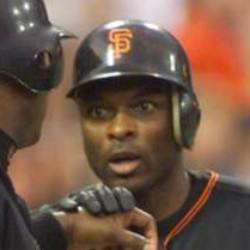

Name of above image: Reggie_Sanders
Result at index 9 : 


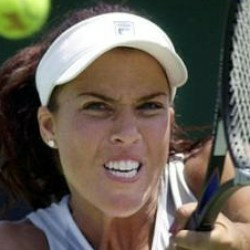

Name of above image: Jennifer_Capriati
Result at index 10 : 


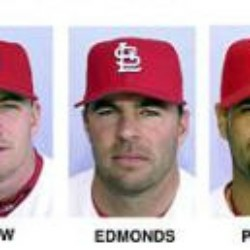

Name of above image: Jim_Edmonds
Result at index 11 : 


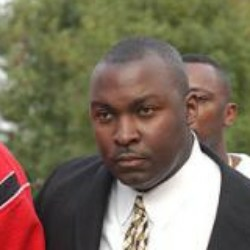

Name of above image: Daryl_Parks
Result at index 12 : 


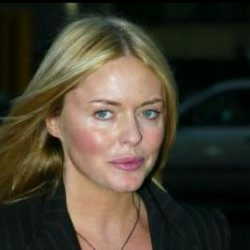

Name of above image: Patsy_Kensit
Result at index 13 : 


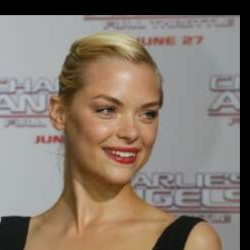

Name of above image: Jamie_King
Result at index 14 : 


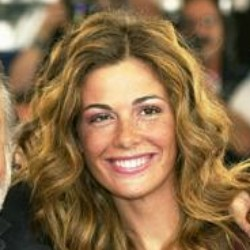

Name of above image: Vanessa_Incontrada
Result at index 15 : 


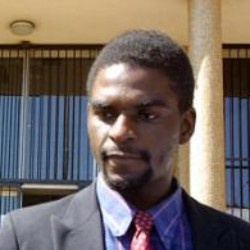

Name of above image: Lloyd_Mudiwa
Result at index 16 : 


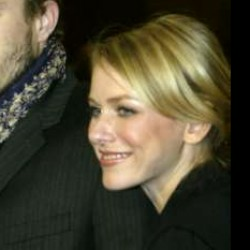

Name of above image: Naomi_Watts
Result at index 17 : 


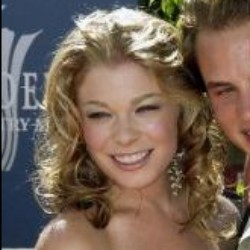

Name of above image: LeAnn_Rimes
Result at index 18 : 


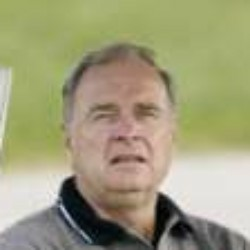

Name of above image: Paul_Martin
Result at index 19 : 


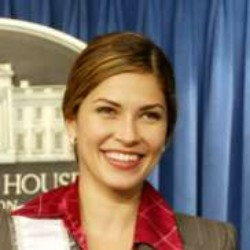

Name of above image: Justine_Pasek

---------



In [74]:
# show search results
generate_knn_images(neigh[targets[9]], ds, labels)